# Aqua Monitor using OpenEO

This notebook implements the [Aqua Monitor](https://aqua-monitor.appspot.com/) algorithm using [OpenEO](https://openeo.org/), an open source processing platfrom for earth observation data.

The goal of aquamonitor is to provide a planetary-scale view on changes in land and water occurrence over time. In other words, it shows how land has changed to surface water and vice-versa. Applications like this give insight in both man-made interventions, as well as changes due to natural variability and climate change.

In this notebook, a global view (although you could put it in the input parameters) is not the goal. For a given area of interest (aoi), the notebook builds a set of instructions using the [OpenEO python client library](https://open-eo.github.io/openeo-python-client/) and sends it to the [OpenEO Platfrom](https://openeo.cloud/) backend for processing. Then the results from the analysis are downloaded and interactively plotted.

## Imports
This notebook has a few dependencies. The main ones being the OpenEO python client library. We also use xarray to analyse downloaded datacubes.

In [17]:
# imports
import math

from openeo import connect, Connection
from openeo.rest.datacube import DataCube
from typing import List, Dict, Tuple, Union
from pathlib import Path
import xarray as xr

from utils import get_files_from_dc
%matplotlib inline

## Connect to the backend
OpenEO features a generic API that can be implemented using many different backends using different implementations. Here we log in with one of those backends using OIDC, using egi as a provider.

In [45]:
# Connect to VITO backend
vito_url: str = "https://openeo.vito.be/openeo/1.0"
vito_creo_url: str = "https://openeo.creo.vito.be"
vito_dev_url: str = "https://openeo-dev.vito.be/openeo/1.0/"
ee_url: str = "https://earthengine.openeo.org"
openeo_platform_url: str = "openeo.cloud"

backend_url: str = vito_url
# con: Connection = connect(ee_url).authenticate_basic(username="group1", password="test123")
con: Connection = connect(backend_url)
con.authenticate_oidc(provider_id="egi")

out_dir = Path("output")
out_dir.mkdir(parents=True, exist_ok=True)

local_cache_file: Path = out_dir / "job_cache.json"
debug = True

Authenticated using refresh token.


## Explore collections and processes
You can interactively explore different collections in the notebook using the `Connection` object.

In [3]:
# con.list_collections()
con.describe_collection("TERRASCOPE_S2_TOC_V2")

{'assets': {'metadata_iso_19139': {'href': 'https://services.terrascope.be/collectioncatalogue/srv/api/records/urn:eop:VITO:TERRASCOPE_S2_TOC_V2/formatters/xml?approved=true',
   'roles': ['metadata', 'iso-19139'],
   'title': 'ISO 19139 metadata',
   'type': 'application/vnd.iso.19139+xml'},
  'thumbnail': {'href': 'https://services.terrascope.be/collectioncatalogue/images/quicklooks/SENTINEL2_TOC_V2_QL.JPG',
   'roles': ['thumbnail'],
   'title': 'Thumbnail',
   'type': 'image/jpeg'}},
 'common_name': 'SENTINEL2_L2A',
 'cube:dimensions': {'bands': {'type': 'bands',
   'values': ['B01',
    'B02',
    'B03',
    'B04',
    'B05',
    'B06',
    'B07',
    'B08',
    'B8A',
    'B11',
    'B12',
    'SCL',
    'relativeAzimuthAngles',
    'sunZenithAngles',
    'viewZenithAngles']},
  't': {'extent': ['2015-07-06T00:00:00Z', None], 'type': 'temporal'},
  'x': {'axis': 'x',
   'extent': [-180, 180],
   'reference_system': {'$schema': 'https://proj.org/schemas/v0.2/projjson.schema.json',
    'area': 'World',
    'bbox': {'east_longitude': 180,
     'north_latitude': 90,
     'south_latitude': -90,
     'west_longitude': -180},
    'coordinate_system': {'axis': [{'abbreviation': 'Lat',
       'direction': 'north',
       'name': 'Geodetic latitude',
       'unit': 'degree'},
      {'abbreviation': 'Lon',
       'direction': 'east',
       'name': 'Geodetic longitude',
       'unit': 'degree'}],
     'subtype': 'ellipsoidal'},
    'datum': {'ellipsoid': {'inverse_flattening': 298.257223563,
      'name': 'WGS 84',
      'semi_major_axis': 6378137},
     'name': 'World Geodetic System 1984',
     'type': 'GeodeticReferenceFrame'},
    'id': {'authority': 'OGC', 'code': 'Auto42001', 'version': '1.3'},
    'name': 'AUTO 42001 (Universal Transverse Mercator)',
    'type': 'GeodeticCRS'},
   'step': 10,
   'type': 'spatial'},
  'y': {'axis': 'y',
   'extent': [-56, 83],
   'reference_system': {'$schema': 'https://proj.org/schemas/v0.2/projjson.schema.json',
    'area': 'World',
    'bbox': {'east_longitude': 180,
     'north_latitude': 90,
     'south_latitude': -90,
     'west_longitude': -180},
    'coordinate_system': {'axis': [{'abbreviation': 'Lat',
       'direction': 'north',
       'name': 'Geodetic latitude',
       'unit': 'degree'},
      {'abbreviation': 'Lon',
       'direction': 'east',
       'name': 'Geodetic longitude',
       'unit': 'degree'}],
     'subtype': 'ellipsoidal'},
    'datum': {'ellipsoid': {'inverse_flattening': 298.257223563,
      'name': 'WGS 84',
      'semi_major_axis': 6378137},
     'name': 'World Geodetic System 1984',
     'type': 'GeodeticReferenceFrame'},
    'id': {'authority': 'OGC', 'code': 'Auto42001', 'version': '1.3'},
    'name': 'AUTO 42001 (Universal Transverse Mercator)',
    'type': 'GeodeticCRS'},
   'step': 10,
   'type': 'spatial'}},
 'description': '[Sentinel-2 Level 2A](https://docs.terrascope.be/#/DataProducts/Sentinel-2/Level2A/Level2A) product, processed from L1C by Sen2Cor. \n Use the [Terrascope viewer](https://viewer.terrascope.be/?language=nl&bbox=0.9339867511378304,50.14520994379217,6.207424251137831,51.77292299745045&overlay=false&bgLayer=MapBox&date=2019-02-25T03:17:15.000Z&layer=CGS_S2_RADIOMETRY) to explore the data. \n\n ',
 'extent': {'spatial': {'bbox': [[-180, -56, 180, 83]]},
  'temporal': {'interval': [['2015-07-06T00:00:00Z', None]]}},
 'id': 'TERRASCOPE_S2_TOC_V2',
 'keywords': ['VITO',
  'TERRASCOPE',
  'COPERNICUS',
  'ESA',
  'Orthoimagery',
  'SENTINEL-2',
  'MSI',
  'Level-2A',
  'Radiometry',
  'Plant Resource',
  'TOC'],
 'license': 'proprietary',
 'links': [{'href': 'https://sentinel.esa.int/documents/247904/690755/Sentinel_Data_Legal_Notice',
   'rel': 'license'},
  {'href': 'https://services.terrascope.be/catalogue/description?collection=urn:eop:VITO:TERRASCOPE_S2_TOC_V2',
   'rel': 'alternate'},
  {'href': 'https://viewer.terrascope.be/?language=nl&bbox=0.9339867511378304,50.14520994379217,6.207424251137831,51.77292299745045&overlay=false&bgLayer=

In [4]:
# con.list_processes()

# Create Mosaic of available imagery.
Processing a `DataCube` starts with loading a collection or multiple collections that the backend has available.
Here we download just the Sentinel2 imagery, filtering on the spatial and temporal extent that we are interested in. As processing for large areas takes time, we calculate for smaller areas. In this case we take an example at Denia Harour in SW Spain.

In [60]:
def get_utm_zone(lon: float) -> int:
    return math.ceil((180 + lon) / 6)

# Define constraints for loading
embalse_de_barbate_bbox: Dict[str, Union[float, str]] = {
    "west": -5.707740783691406,
    "east": -5.6764984130859375,
    "south": 36.40221798067486,
    "north": 36.4315034892636,
    "crs": "EPSG:4326"
}
denia_harbour_bbox: Dict[str, Union[float, str]] = {
    "west": 0.10594089795383788,
    "east": 0.12937267590793944,
    "south": 38.83464299556706,
    "north": 38.85035302841166,
    "crs": "EPSG:4326"
}
sw_spain_bbox: Dict[str, Union[float, str]] = {
    "west": -7.682155041704681,
    "east": -5.083888440142181,
    "south": 36.18203953636458,
    "north": 38.620982842287496,
    "crs": "EPSG:4326"
}
spain_bounding_box: Dict[str, Union[float, str]] = {
    "west": -9.39288367353,
    "east": 3.03948408368,
    "south": 35.946850084,
    "north": 43.7483377142,
    "crs": "EPSG:4326"
}

if debug:
    spatial_extent: Dict[str, Union[float, str]] = embalse_de_barbate_bbox
    utm_zone = get_utm_zone(embalse_de_barbate_bbox["west"])
else:
    spatial_extent: Dict[str, Union[float, str]] = sw_spain_bbox
    utm_zone = get_utm_zone(sw_spain_bbox["west"])

smoothing_resolution: float = 30.0  # meters
if debug:
    plot_resolution: float = 10.0 # meters
else:
    plot_resolution: float = 1000.0  # meters

if debug:
    temporal_extent: List[str] = ["2019-01-01", "2022-01-01"]
else:
    temporal_extent: List[str] = ["2019-01-01", "2022-01-01"]

raw_netcdf_filename: str = "raw.nc"

if backend_url == openeo_platform_url:
    collection_id = "TERRASCOPE_S2_TOC_V2",
elif backend_url == vito_url or vito_dev_url:
    collection_id = "SENTINEL2_L1C_SENTINELHUB"
band_names = ["swir", "nir", "green"]
bands = ["B11", "B08", "B03"]
        
dc: DataCube = con.load_collection(
    collection_id=collection_id,
    spatial_extent=spatial_extent,
    temporal_extent=temporal_extent,
    bands=bands
    ).add_dimension(name="source_name", label=collection_id, type="other") \
    .rename_labels(dimension="bands", source=bands, target=band_names)

### Download Source Data
To explore the resulting data, it is possible to download this data. There are two ways of doing this. Synchronously with the `.download` method on the `DataCube` object, or asynchronously by starting a batch job. For production or large jobs, it is better to do this using a batch job, as synchronous jobs are tied to a timeout. The processing speed of a synchronous job also depends on the load on the server, while batch jobs are queued up and always executed when there is space on the server.

In [ ]:
dc.download(out_dir / "raw.nc", format="netcdf")
# Also download for udf testing in JSON format
# dc.download(out_dir / "raw.json", format="Json")

In [6]:
from utils import get_files_from_dc
files = get_files_from_dc(dc, out_directory=out_dir / "raw", job_name="get_collection", local_cache_file=out_dir / "cache.json")

2022-08-09 11:24:53,744 - cached_job - INFO - 0:00:00 Job 'j-daeae9152ef941389c66729f0c93ad02': send 'start'
2022-08-09 11:24:54,765 - cached_job - INFO - 0:00:01 Job 'j-daeae9152ef941389c66729f0c93ad02': finished (progress N/A)


In [10]:
data_set_raw: xr.Dataset = xr.open_dataset(out_dir / "raw" / "openEO.nc")
# data_set_raw: xr.Dataset = xr.open_dataset(out_dir / raw_netcdf_filename)

In [13]:
data_set_raw

<xarray.Dataset>
Dimensions:  (t: 220, x: 290, y: 333)
Coordinates:
  * t        (t) datetime64[ns] 2019-01-02 2019-01-07 ... 2021-12-27 2022-01-01
  * x        (x) float64 2.572e+05 2.572e+05 2.572e+05 ... 2.601e+05 2.601e+05
  * y        (y) float64 4.035e+06 4.035e+06 4.035e+06 ... 4.032e+06 4.032e+06
Data variables:
    crs      |S1 ...
    swir     (t, y, x) float32 ...
    nir      (t, y, x) float32 ...
    green    (t, y, x) float32 ...
Attributes:
    Conventions:  CF-1.8
    institution:  openEO platform - Geotrellis backend: 0.6.4a1
    description:  
    title:

### Visualize Raw data

Here we use [Open Street Map](https://www.openstreetmap.org) as well as the [holoviews](https://holoviews.org/) package, and its extension, [geoviews](https://geoviews.org/). Other standard tools such as bokeh (plotting backend) and cartopy (crs transforms) are used here as well.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
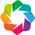

In [11]:
import cartopy.crs as ccrs

import geoviews as gv
import holoviews as hv
import numpy as np

from holoviews import opts, streams
from holoviews.element.tiles import OSM

gv.extension("bokeh","matplotlib")

In [19]:
kdims = ["x", "y", "t"]
vdims = ["swir", "nir", "green"]

data_set_raw_fixed = data_set_raw.drop("crs")
hv.Dimension.type_formatters[np.datetime64] = '%Y-%m-%d'  # readable time format
gv_raw = gv.Dataset(data_set_raw_fixed, kdims=kdims, vdims=vdims, crs=ccrs.UTM(utm_zone)).redim(x="lon", y="lat")

print(repr(gv_raw))

:Dataset   [lon,lat,t]   (swir,nir,green)


In [20]:
dmap = gv_raw.to(gv.Image, ["lon", "lat"], "green", group="raw_data", label="raw", datatype=["xarray"], dynamic=True)
overlay = OSM() * dmap
overlay.opts(
    opts.Image(cmap="turbo", colorbar=True, clim=(0, 7000), height=500, width=500, tools=["hover"]),
    opts.Tiles(height=500, width=500))

overlay

:DynamicMap   [t]
   :Overlay
      .Tiles.I      :Tiles   [x,y]
      .Raw_data.Raw :Image   [lon,lat]   (green)

# Smoothen images
In order for the algorithm to function better, images are slightly smoothed spatially, using the `.resample_spatial` method.

In [21]:
smoothed_dc = dc.resample_spatial(method="cubic", resolution=smoothing_resolution)

In [ ]:
smoothed_dc_filename = out_dir / "smoothed.nc"
smoothed_dc.download(smoothed_dc_filename, format="netcdf")

In [ ]:
data_set_raw: xr.Dataset = xr.open_dataset(smoothed_dc_filename)
data_set_raw["green"].hvplot(
    groupby="t",
    cmap="turbo",
    widget_type="scrubber",
    widget_location="bottom"
)

## Divide the data into time-bands
Filtering clouds and other atmospheric effects is notoriously difficult, especially if the algorithm has to work globally. Luckily, we are interested on long-term changes, which means that we can make use of composites images that use multiple years of data to achieve a good cloud-free image. Here we assume that over the time period chosen, changes such as seasonal effects, are relatively stable.
The smoothed input data is divided in bands of a variable amount of years. The data is sorted and the n-th percentile of every time-band is used for further analysis. The percentile is based on the MODIS cloud cover percentage dataset.

In [22]:
from pathlib import Path
from datetime import timedelta
import pandas as pd

year_interval: int = 1
percentile: float = 0.2  # fractions [0 - 1]
bucketed_netcdf_filename: str = "bucketed.nc"

if debug:
    dr: pd.DatetimeIndex = pd.date_range(start=temporal_extent[0], end=temporal_extent[1], freq=f"{year_interval}YS")
else:
    dr: pd.DatetimeIndex = pd.date_range(start=temporal_extent[0], end=temporal_extent[1], freq=f"{year_interval}YS")

In [23]:
from openeo import processes

if debug:
    image_count_limit: int = 5  # Will exclude some images
else:
    image_count_limit: int = 10

t_intervals = [[str(d), str(dr[i+1])] for i, d in enumerate(dr[:-1])]

# Create bucketed DC based on percentile of images
t_bucketed_dc: DataCube = smoothed_dc \
    .aggregate_temporal(
        intervals=t_intervals,
        reducer=lambda data: processes.quantiles(data, probabilities=[percentile]),
        labels=[t_int[0] for t_int in t_intervals]
    )

print(len(t_intervals))

3


## Create a cache in the OpenEO backend
Because we are severely cutting down on the size of the total dataset in the previous timebanding step, caching the data here helps quick development and saves many cloud resources.

In [24]:
from utils import get_or_create_cached_cube
if not debug:
    t_bucketed_dc = get_or_create_cached_cube(
        dc=t_bucketed_dc,
        local_cache_file=local_cache_file,
        temporal_extent=tuple(temporal_extent),
        spatial_extent={
            "x": (spatial_extent["west"], spatial_extent["east"]),
            "y": (spatial_extent["north"], spatial_extent["south"])
        },
        job_name="t_bucketing_aquamonitor",
        result_format="gtiff"
    )

## Count the number of images included in each interval
To check whether there are enough images available for a meaningful composite image, we filter for a certain number of images present in each timestep.

In [25]:
# Workaround for now is to set images to 1 until count works
# debug count_dc
count_dc: DataCube = smoothed_dc.band("green") \
    .apply(lambda x: x * 0 + 1) \
    .aggregate_temporal(
        intervals=t_intervals,
        reducer=lambda data: processes.sum(data),
        labels=[t_int[0] for t_int in t_intervals]
    )

In [ ]:
count_dc_filename = out_dir / "count.nc"
count_dc.download(count_dc_filename, format="netcdf")

### Download files for count and time bucketing

In [29]:
# files = get_files_from_dc(t_bucketed_dc, out_dir / "bucketed", "t_bucketing_aquamonitor")
c_files = get_files_from_dc(count_dc, out_dir / "count", "counting_buckets_aquamonitor")

2022-08-09 11:59:48,965 - cached_job - INFO - logging file not found, creates a local log file at None when saving.
2022-08-09 11:59:48,968 - cached_job - INFO - cached job not found in backend, creating a job 'counting_buckets_aquamonitor' in the backend.
2022-08-09 11:59:49,804 - cached_job - INFO - 0:00:00 Job 'j-91179bc8a89245069444563e8141828d': send 'start'
2022-08-09 12:00:16,777 - cached_job - INFO - 0:00:26 Job 'j-91179bc8a89245069444563e8141828d': queued (progress N/A)
2022-08-09 12:00:22,221 - cached_job - INFO - 0:00:32 Job 'j-91179bc8a89245069444563e8141828d': queued (progress N/A)
2022-08-09 12:00:28,858 - cached_job - INFO - 0:00:39 Job 'j-91179bc8a89245069444563e8141828d': queued (progress N/A)
2022-08-09 12:00:37,066 - cached_job - INFO - 0:00:47 Job 'j-91179bc8a89245069444563e8141828d': queued (progress N/A)
2022-08-09 12:00:47,210 - cached_job - INFO - 0:00:57 Job 'j-91179bc8a89245069444563e8141828d': queued (progress N/A)
2022-08-09 12:00:59,868 - cached_job - INFO 

In [31]:
c_files

[PosixPath('output/count/openEO.nc')]

In [ ]:
data_set_bucketed: xr.Dataset = xr.open_dataset(out_dir / "count" / "openEO.nc")
data_set_bucketed

In [40]:
kdims = ["x", "y", "t"]
vdims = ["var"]

data_set_bucketed_fixed = data_set_bucketed.drop("crs")
hv.Dimension.type_formatters[np.datetime64] = '%Y-%m-%d'  # readable time format
gv_bucketed = gv.Dataset(data_set_bucketed_fixed, kdims=kdims, vdims=vdims, crs=ccrs.UTM(utm_zone)).redim(x="lon", y="lat")

print(repr(gv_bucketed))

:Dataset   [lon,lat,t]   (var)


In [42]:
dmap = gv_bucketed.to(gv.Image, ["lon", "lat"], "var", group="raw_data", label="raw", datatype=["xarray"], dynamic=True)
overlay = OSM() * dmap
overlay.opts(
    opts.Image(cmap="turbo", colorbar=True, clim=(0, 100), height=500, width=500, tools=["hover"]),
    opts.Tiles(height=500, width=500))

overlay

:DynamicMap   [t]
   :Overlay
      .Tiles.I      :Tiles   [x,y]
      .Raw_data.Raw :Image   [lon,lat]   (var)

## Create the time-bucketed NDWI cube
To detect surface-to-water changes and vice-versa, we rely on the NDWI: $$NDWI = \frac{\rho_{green} - \rho_{nir}}{\rho_{green} + \rho_{nir}}$$
and on the MNDWI: $$MNDWI = \frac{\rho_{green} - \rho_{swir}}{\rho_{green} + \rho_{swir}}$$

In [43]:
# Create products
from typing import Tuple

green: DataCube = t_bucketed_dc.band("green")
nir: DataCube = t_bucketed_dc.band("nir")
swir: DataCube = t_bucketed_dc.band("swir")
ndwi: DataCube = (green - nir) / (green + nir)
mndwi: DataCube = (green - swir) / (green + swir)

# Rescale
def rescale(dc: DataCube, factors: Tuple[float]) -> DataCube:
    return dc.subtract(factors[0]).divide(factors[1] - factors[0])

rescaled_mndwi = rescale(mndwi, factors=(-0.6, 0.6))

### Download the MNDWI results
For the interactive plot, we need to get the MNDWI results in as a Cloud Optimized GeoTiff. We can accomplish this by saving to the geotiff format and using a batch format. For now, the results of a batch operation stay reachable in the openEO backend for 3 months.

In [ ]:
# Also download dataset for local testing with linear regression
# rescaled_mndwi.download(out_dir / "mndwi.nc", format="NetCDF")
# green.download(out_dir / "green.nc", format="NetCDF")
# swir.download(out_dir / "swir.nc", format="NetCDF")
# mndwi.download(out_dir / "mndwi.json", format="json")

In [63]:
from utils import get_urls_from_dc
urls = get_urls_from_dc(rescaled_mndwi.resample_spatial(method="cubic", resolution=plot_resolution), 'mndwi_calculation', result_format="gtiff", local_cache_file=local_cache_file)

2022-08-09 15:19:03,790 - cached_job - INFO - cached job not found in backend, creating a job 'mndwi_calculation' in the backend.
2022-08-09 15:19:04,532 - cached_job - INFO - 0:00:00 Job 'j-759d33e2ff014530946bf680b6b0ae3d': send 'start'
2022-08-09 15:19:33,545 - cached_job - INFO - 0:00:29 Job 'j-759d33e2ff014530946bf680b6b0ae3d': queued (progress N/A)
2022-08-09 15:19:38,957 - cached_job - INFO - 0:00:34 Job 'j-759d33e2ff014530946bf680b6b0ae3d': queued (progress N/A)
2022-08-09 15:19:45,597 - cached_job - INFO - 0:00:41 Job 'j-759d33e2ff014530946bf680b6b0ae3d': queued (progress N/A)
2022-08-09 15:19:53,816 - cached_job - INFO - 0:00:49 Job 'j-759d33e2ff014530946bf680b6b0ae3d': queued (progress N/A)
2022-08-09 15:20:03,969 - cached_job - INFO - 0:00:59 Job 'j-759d33e2ff014530946bf680b6b0ae3d': queued (progress N/A)
2022-08-09 15:20:16,592 - cached_job - INFO - 0:01:12 Job 'j-759d33e2ff014530946bf680b6b0ae3d': queued (progress N/A)
2022-08-09 15:20:32,241 - cached_job - INFO - 0:01:27

In [64]:
urls

['https://openeo.vito.be/openeo/1.0/jobs/j-759d33e2ff014530946bf680b6b0ae3d/results/assets/Zjg5MzBhNWQxNmJhMTMxNWE1ZTVkNzM4MTJiZDRmZjM1ZTkxM2Y4NWM4OTQ5NzEyMzE0YjYxMTE0MjZmY2MyY0BlZ2kuZXU%3D/35d0c0fc038e880691780993fd0db924/openEO_2019-01-01Z.tif?expires=1660663449',
 'https://openeo.vito.be/openeo/1.0/jobs/j-759d33e2ff014530946bf680b6b0ae3d/results/assets/Zjg5MzBhNWQxNmJhMTMxNWE1ZTVkNzM4MTJiZDRmZjM1ZTkxM2Y4NWM4OTQ5NzEyMzE0YjYxMTE0MjZmY2MyY0BlZ2kuZXU%3D/c3b3a7cb3d749e9afb00299c8893003c/openEO_2020-01-01Z.tif?expires=1660663449',
 'https://openeo.vito.be/openeo/1.0/jobs/j-759d33e2ff014530946bf680b6b0ae3d/results/assets/Zjg5MzBhNWQxNmJhMTMxNWE1ZTVkNzM4MTJiZDRmZjM1ZTkxM2Y4NWM4OTQ5NzEyMzE0YjYxMTE0MjZmY2MyY0BlZ2kuZXU%3D/e9df6fdd5926afd66009bb167a7873a8/openEO_2021-01-01Z.tif?expires=1660663449']

Or use a synchronous job:

In [ ]:
rescaled_mndwi.resample_spatial(method="cubic", resolution=plot_resolution).download(out_dir / "mndwi_cache.nc")

### Plot the mndwi results

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
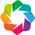

In [65]:
import cartopy.crs as ccrs

import geoviews as gv
import holoviews as hv
import numpy as np
import panel as pn

from holoviews import opts, streams
from holoviews.element.tiles import OSM

gv.extension("bokeh","matplotlib")

In [66]:
ds = xr.open_dataset(urls[0], engine="rasterio")

In [67]:
ds

<xarray.Dataset>
Dimensions:      (band: 1, x: 290, y: 333)
Coordinates:
  * band         (band) int64 1
  * x            (x) float64 2.572e+05 2.572e+05 ... 2.601e+05 2.601e+05
  * y            (y) float64 4.035e+06 4.035e+06 ... 4.032e+06 4.032e+06
    spatial_ref  int64 ...
Data variables:
    band_data    (band, y, x) float32 ...

In [69]:
dim = xr.Variable(dims="t", data=dr[:-1])
data_set_mndwi = xr.concat([xr.open_dataset(url, engine="rasterio") for url in urls], dim=dim)
da_mndwi = data_set_mndwi.rename(band_data="mndwi").drop("band")["mndwi"]
da_mndwi

<xarray.DataArray 'mndwi' (t: 3, band: 1, y: 333, x: 290)>
array([[[[0.312773  , 0.312773  , 0.29254767, ..., 0.32126877,
          0.31672305, 0.30415815],
         [0.312773  , 0.312773  , 0.29254767, ..., 0.32126877,
          0.31672305, 0.30415815],
         [0.30993733, 0.30993733, 0.2943335 , ..., 0.2970852 ,
          0.29624626, 0.2903627 ],
         ...,
         [0.2191499 , 0.2191499 , 0.22768435, ..., 0.21744464,
          0.21840906, 0.22079594],
         [0.21781144, 0.21781144, 0.22373857, ..., 0.22292012,
          0.22144963, 0.21895629],
         [0.21614245, 0.21614245, 0.21976785, ..., 0.22740081,
          0.22432007, 0.21840484]]],


       [[[0.31152055, 0.31152055, 0.29768905, ..., 0.34368768,
          0.33177003, 0.31008852],
         [0.31152055, 0.31152055, 0.29768905, ..., 0.34368768,
          0.33177003, 0.31008852],
         [0.31126818, 0.31126818, 0.29936966, ..., 0.31459445,
...
          0.26406825, 0.26908967],
         [0.25616354, 0.25616354, 0.2603657 , ..., 0.25449595,
          0.25836325, 0.26444548],
         [0.25581604, 0.25581604, 0.26121262, ..., 0.25051802,
          0.25461435, 0.2612215 ]]],


       [[[0.31407088, 0.31407088, 0.29041663, ..., 0.3082093 ,
          0.29783884, 0.28330132],
         [0.31407088, 0.31407088, 0.29041663, ..., 0.3082093 ,
          0.29783884, 0.28330132],
         [0.3049256 , 0.3049256 , 0.28673232, ..., 0.28534985,
          0.27862734, 0.27007627],
         ...,
         [0.2554416 , 0.2554416 , 0.2579785 , ..., 0.24003205,
          0.24279818, 0.24648476],
         [0.24211909, 0.24211909, 0.24700537, ..., 0.2346149 ,
          0.23781842, 0.24386129],
         [0.22955811, 0.22955811, 0.236919  , ..., 0.2316864 ,
          0.23516355, 0.24275121]]]], dtype=float32)
Coordinates:
  * x            (x) float64 2.572e+05 2.572e+05 ... 2.601e+05 2.601e+05
  * y            (y) float64 4.035e+06 4.035e+06 ... 4.032e+06 4.032e+06
    spatial_ref  int64 0
  * t            (t) datetime64[ns] 2019-01-01 2020-01-01 2021-01-01
Dimensions without coordinates: band

In [71]:
kdims = ["x", "y", "t"]
vdims = ["mndwi"]

hv.Dimension.type_formatters[np.datetime64] = '%Y-%m-%d'  # readable time format
lon = hv.Dimension("lon", label="longitude", unit="deg Northing")
lat = hv.Dimension("lat", label="latitude", unit="deg Easting")
gv_mndwi = gv.Dataset(da_mndwi, kdims=kdims, vdims=vdims, crs=ccrs.UTM(utm_zone)).redim(x=lon, y=lat)

img = gv_mndwi.to(gv.Image, ["lon", "lat"], "mndwi", group="mndwi", label="mndwi", datatype=["xarray"], dynamic=True)
img = img.redim(x=lon, y=lat)
overlay = OSM() * img
overlay.opts(
    opts.Image(cmap="turbo", colorbar=True, clim=(-1, 1), height=500, width=500, alpha=0.8),
    opts.Tiles(height=500, width=500))

:DynamicMap   [t]
   :Overlay
      .Tiles.I     :Tiles   [x,y]
      .Mndwi.Mndwi :Image   [lon,lat]   (mndwi)

## Perform a linear regression on each band
Compute the linear regression for the ndwi we use as our wetness indicator. The slope of the linear regression will be the indicator water-to-surface changes or vice-versa.

In [15]:
def load_udf(udf_path: Union[str, Path]):
    with open(udf_path, "r+") as f:
        return f.read()

linear_regression_udf_path: Path = Path(Path.cwd().parent / "udfs" / "linear_regression.py")
linear_regression_udf: str = load_udf(linear_regression_udf_path)

For debugging purposes, we can run the udf locally

In [ ]:
# Tryout the UDF locally
from openeo.udf import execute_local_udf, UdfData

# out_dir_udf = out_dir / "out"
# out_dir_udf.mkdir(parents=True, exist_ok=True)
ds = xr.open_dataset(out_dir / "mndwi.nc", engine='netcdf4')

r = ds["var"]
# build dimension list in proper order
dims = list(filter(lambda i: i != 't' and i != 'bands' and i != 'x' and i != 'y', r.dims))
if 't' in r.dims: dims += ['t']
if 'bands' in r.dims: dims += ['bands']
if 'x' in r.dims: dims += ['x']
if 'y' in r.dims: dims += ['y']
# return the resulting data array
local_da: xr.DataArray = r.transpose(*dims)
udf_res: UdfData = execute_local_udf(linear_regression_udf, local_da)
udf_res.get_datacube_list()[0].get_array().hvplot(
    cmap="turbo",
    widget_type="scrubber",
    widget_location="bottom"
)

In [16]:
lin_reg: DataCube = rescaled_mndwi.reduce_temporal_udf(code=linear_regression_udf, runtime="Python")

## Masking
Masks are created for areas that:
- have too few images
- have no clear changes from land-to-water or vice versa

In [17]:
from openeo import processes
from dateutil.parser import parse
from datetime import datetime

ndwi_min_water: float = -0.05 # minimum value of NDWI to assume as water
ndwi_max_land: float = 0.5
slope_threshold: float = 0.025
start: datetime = parse(temporal_extent[0])
stop: datetime = parse(temporal_extent[1])

if debug:
    min_num_images: int = 5
else:
    min_num_images: int = 20

# 15 / (stop_year - start_year)
slope_threshold_ratio: float = 15 * 365.25 / float(stop.__sub__(start).days)
print(slope_threshold_ratio)

mndwi_min: DataCube = mndwi.reduce_dimension(dimension="t", reducer="min")
mndwi_max: DataCube = mndwi.reduce_dimension(dimension="t", reducer="max")
min_water_mask: DataCube = mndwi_min.apply(lambda val: processes.lte(x=val, y=ndwi_max_land))  # invert mask, should be processes.gte
max_land_mask: DataCube = mndwi_max.apply(lambda val: processes.gte(x=val, y=ndwi_min_water))  # invert mask, should be processes.lte

# Create bucketed DC based on image count
# Workaround for now is to set images to 1 until count works
num_images_mask: DataCube = smoothed_dc.band("green") \
    .apply(lambda data: processes.add(x=processes.multiply(x=data, y=0), y=1)) \
    .aggregate_temporal(
        intervals=t_intervals,
        reducer=lambda data: processes.sum(data),
        labels=[t_int[0] for t_int in t_intervals]
    ) \
    .apply(lambda val: processes.gte(x=val, y=image_count_limit)) \
    .reduce_dimension(
        dimension="t",
        reducer=lambda data: processes.product(data)
    ) \
    .apply(lambda data: processes.eq(x=data, y=0))  # after multiplying masks, invert

mask: DataCube = lin_reg.apply(processes.absolute).apply(lambda val: processes.lte(x=val, y=slope_threshold * slope_threshold_ratio)) \
    .multiply(min_water_mask) \
    .multiply(max_land_mask) \
    .multiply(num_images_mask) \
    .apply(lambda data: processes.eq(x=data, y=0))  # after multiplying masks, invert

lin_reg = lin_reg.mask(mask)

4.998859489051095


### Debug masks

In [18]:
min_water_mask.download(out_dir / "min_water_mask.nc", format="netcdf")
max_land_mask.download(out_dir / "max_land_mask.nc", format="netcdf")
num_images_mask.download(out_dir / "num_images_mask.nc", format="netcdf")
mask.download(out_dir / "final_mask.nc", format="netcdf")

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
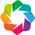

:Overlay
   .Tiles.I   :Tiles   [x,y]
   .Mask.Mask :Image   [lon,lat]   (mask)

In [31]:
import cartopy.crs as ccrs

import geoviews as gv
import holoviews as hv
import numpy as np
import panel as pn

from holoviews import opts, streams
from holoviews.element.tiles import OSM

gv.extension("bokeh","matplotlib")

data_set_mask: xr.Dataset = xr.open_dataset(out_dir / "final_mask.nc").rename(var="mask")

kdims = ["x", "y"]
vdims = ["mask"]

hv.Dimension.type_formatters[np.datetime64] = '%Y-%m-%d'  # readable time format
lon = hv.Dimension("lon", label="longitude", unit="deg Northing")
lat = hv.Dimension("lat", label="latitude", unit="deg Easting")
gv_mask = gv.Dataset(data_set_mask, kdims=kdims, vdims=vdims, crs=ccrs.UTM(31)).redim(x=lon, y=lat)

img = gv_mask.to(gv.Image, ["lon", "lat"], "mask", group="mask", label="mask", datatype=["xarray"])
img = img.redim(x=lon, y=lat)
overlay = OSM() * img

overlay.opts(
    opts.Image(colorbar=False, clim=(0, 1), height=500, width=500, tools=["hover"], alpha=0.8),
    opts.Tiles(height=500, width=500))

### Download the Linear Regression results

In [ ]:
lin_reg.download(out_dir / "lin_reg.nc", format="netcdf")
# mask.download(out_dir / "mask.nc", format="netcdf")

In [22]:
files = get_files_from_dc(lin_reg.resample_spatial(method="cubic", resolution=plot_resolution), out_dir / "lin_reg", 'linear_regression aquamonitor')

2022-02-01 11:03:00,390 - utils - INFO - 0:02:39 Job 'vito-23512e69-5f56-4f87-aa71-5d7d57874fe4': queued (progress N/A)
2022-02-01 11:03:07,375 - utils - INFO - 0:02:46 Job 'vito-23512e69-5f56-4f87-aa71-5d7d57874fe4': queued (progress N/A)
2022-02-01 11:03:15,231 - utils - INFO - 0:02:54 Job 'vito-23512e69-5f56-4f87-aa71-5d7d57874fe4': queued (progress N/A)
2022-02-01 11:03:23,832 - utils - INFO - 0:03:02 Job 'vito-23512e69-5f56-4f87-aa71-5d7d57874fe4': queued (progress N/A)
2022-02-01 11:03:37,128 - utils - INFO - 0:03:16 Job 'vito-23512e69-5f56-4f87-aa71-5d7d57874fe4': queued (progress N/A)
2022-02-01 11:03:50,255 - utils - INFO - 0:03:29 Job 'vito-23512e69-5f56-4f87-aa71-5d7d57874fe4': queued (progress N/A)
2022-02-01 11:04:07,439 - utils - INFO - 0:03:46 Job 'vito-23512e69-5f56-4f87-aa71-5d7d57874fe4': queued (progress N/A)
2022-02-01 11:05:08,108 - utils - INFO - 0:04:47 Job 'vito-23512e69-5f56-4f87-aa71-5d7d57874fe4': queued (progress N/A)
2022-02-01 11:05:33,272 - utils - INFO -

Or download files from a recent successful job:

In [18]:
from openeo.rest.job import RESTJob

files = []
job = RESTJob("vito-5af745a3-9845-485b-92ff-861c84ae011a", con)
results = job.get_results()
for asset in results.get_assets():
    meta_type: str = asset.metadata["type"]
    if meta_type.startswith("application/x-netcdf") or meta_type.startswith("image/tiff"):
        file: Path = asset.download(out_dir / asset.name, chunk_size=2 * 1024 * 1024)
        files.append(file)

### Plot the results of the Linear Regression

In [19]:
# data_set_lin_reg: xr.Dataset = xr.open_dataset(out_dir / "lin_reg" / "openEO.nc").rename(var="lin_reg")
data_set_lin_reg: xr.Dataset = xr.open_dataset(out_dir / "openEO.nc").rename(var="lin_reg")
data_set_lin_reg

<xarray.Dataset>
Dimensions:  (x: 238, y: 278)
Coordinates:
  * x        (x) float64 6.152e+05 6.162e+05 6.172e+05 ... 8.513e+05 8.523e+05
  * y        (y) float64 4.281e+06 4.28e+06 4.279e+06 ... 4.004e+06 4.003e+06
Data variables:
    crs      |S1 ...
    lin_reg  (y, x) float32 ...
Attributes:
    Conventions:  CF-1.8
    institution:  openEO platform - Geotrellis backend: 0.6.1a1
    description:  
    title:

Or we can take more time and plo the results on a map projection with OpenStreetMap in the background. We also want to have some interactivity by checking where the linear regression data comes from. We use the source data from the rescaled MNDWI to create an interactive timeseries when selected on the Map. We do not want to download the full dataset locally, so we choose to use the COG (cloud optimized geotiffs).

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
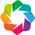

In [20]:
import cartopy.crs as ccrs

import geoviews as gv
import holoviews as hv
import numpy as np
import panel as pn

from holoviews import opts, streams
from holoviews.element.tiles import OSM

gv.extension("bokeh","matplotlib")

We still have a problem plotting an image this large in jupyterlab, so we take an interesting area:

In [21]:
# from rasterio.crs import CRS
# from rasterio.windows import from_bounds
# from pyproj import Transformer

# bounds: Dict[str, float] = {
#     "top": -6.5,
#     "right": 36.5,
#     "bottom": -5.5,
#     "left": 37.5
# }

# crs_source = CRS.from_string("epsg:4326")
# crs_dest = rasterio.open(urls[0]).crs

# transformer = Transformer.from_crs(crs_source, crs_dest)
# bounds["left"], bounds["top"] = transformer.transform(bounds["left"], bounds["top"])
# bounds["right"], bounds["bottom"] = transformer.transform(bounds["right"], bounds["bottom"])

# window = from_bounds(**bounds, transform=rasterio.open(urls[0]).transform)

# data_set_lin_reg.rio.write_crs(crs_dest, inplace=True)
# data_set_lin_reg_clipped: xr.Dataset = data_set_lin_reg.rio.clip_box(maxx=bounds["right"], minx=bounds["left"], maxy=bounds["top"], miny=bounds["bottom"])
# data_set_lin_reg_clipped

In [22]:
kdims = ["x", "y"]
vdims = ["lin_reg"]

hv.Dimension.type_formatters[np.datetime64] = '%Y-%m-%d'  # readable time format
lon = hv.Dimension("lon", label="longitude", unit="deg Northing")
lat = hv.Dimension("lat", label="latitude", unit="deg Easting")
gv_lin_reg = gv.Dataset(data_set_lin_reg, kdims=kdims, vdims=vdims, crs=ccrs.UTM(zone=29, southern_hemisphere=False)).redim(x=lon, y=lat)
# gv_lin_reg = gv.Dataset(data_set_lin_reg, kdims=kdims, vdims=vdims, crs=crs).redim(x=lon, y=lat)

print(repr(gv_lin_reg))

:Dataset   [lon,lat]   (lin_reg)


In [24]:
from rasterio.transform import rowcol
from rasterio.windows import Window
import rasterio

img = gv_lin_reg.to(gv.Image, ["lon", "lat"], "lin_reg", group="lin_reg", label="linear regression", datatype=["xarray"])
img = img.redim(x=lon, y=lat)
overlay = OSM() * img

def get_mndwi_ts(x, y):
    """
    reads from mndwi COG based on coordinates and returns timeseries values
    """
    time = hv.Dimension("t", label="time")
    mndwi = hv.Dimension("norm mndwi", label="norm MNDWI")
    ts = []
    for url in mndwi_urls:
        with rasterio.open(url) as src:
            xs, ys = rowcol(src.transform, x, y)
            with open(out_dir / "log.txt", "w+") as f:
                f.write(f"""
                    x={x}, y={y}
                    xs={xs}, ys={ys}
                """)
            ts.append(src.read(window=Window(ys, xs, 1, 1)).flatten()[0])
    return hv.Curve(ts, time, mndwi)
    # return hv.Curve(da_mndwi.sel(x=x, y=y, method="nearest"), time, mndwi)
    
clicker = streams.Tap(name="location", source=img, x=data_set_lin_reg["x"].values[0], y=data_set_lin_reg["y"].values[0])
timeseries = hv.DynamicMap(callback=get_mndwi_ts, streams=[clicker])

layout = overlay + timeseries
layout.opts(
    opts.Image(cmap="turbo", colorbar=True, clim=(-100, 100), height=500, width=500, tools=["hover"], alpha=0.8),
    opts.Tiles(height=500, width=500),
    opts.Curve(height=200, width=300, ylim=(-1, 1)))

:Layout
   .Overlay.I    :Overlay
      .Tiles.I                   :Tiles   [x,y]
      .Lin_reg.Linear_regression :Image   [lon,lat]   (lin_reg)
   .DynamicMap.I :DynamicMap   []
      :Curve   [t]   (norm mndwi)